# wikipedia hyperlink network visualization

The goal of this project is to visualize and understand a data set.

This project uses __PySpark__ to handle the data.

The subject of this project is a large strongly connected network of wikipedia hyperlinks


## the data

data: https://snap.stanford.edu/data/wiki-topcats.html

source: Jure Leskovec, Stanford University

_This is a web graph of Wikipedia hyperlinks collected in September 2011. The network was constructed by first taking the largest strongly connected component of Wikipedia, then restricting to pages in the top set of categories (those with at least 100 pages), and finally taking the largest strongly connected component of the restricted graph._

The dataset contains a reference to 1,791,489 of the (currently) 6,177,546 english wikipedia articles
 
the data rests in 3 text files of each ±40MB

- page names
    - a line consists of a page ID and a page name
    - _0 Chiasmal syndrome_
    - these are the vertices of the graph
- reduced
    - a line consists of 2 tab separated IDs
    - _52\t401135_
    - these are the edges of the graph
- categories
    - Category:"Category_name"; (series of numbers)
    - _Category:Buprestoidea; 301 302 303_
    - the numbers represent the pages in the category 

## Startup Spark

I start spark from CLI with this command:

`pyspark PYSPARK_PYTHON=python3.8 PYSPARK_DRIVER_PYTHON=python3.8 --packages graphframes:graphframes:0.8.1-spark3.0-s_2.12`

In [1]:
from pyspark import SparkContext
from pyspark.sql import SQLContext
from graphframes import *
import pyspark.sql.functions as f

sc = SparkContext.getOrCreate()
sqlc  = SQLContext(sc)

## Read in the data 

In [3]:
names = sc.textFile("../data/wiki-topcats-page-names.txt")
edges = sc.textFile("../data/wiki-topcats-reduced.txt")

print(f"there are {names.count()} articles in the dataset")
print(f"there are {edges.count()} links in the dataset")

there are 1791489 articles in the dataset
there are 2645247 links in the dataset


## some helper methods

In [4]:
def getNameByNumber(num):
    num_str = str(num)+' '
    name_filter = names.filter(lambda x: num_str in x[:len(str(num))+1])\
        .map(lambda x: x[len(str(num))+1:])
    name = name_filter.collect()
    return name[0]
    
def getLinksByNumber(num):
    num_str = str(num)+'\t'
    edge_filter = edges.filter(lambda x: num_str in x[:len(str(num))+1])\
        .map(lambda x: x[len(str(num))+1:])
    links = edge_filter.collect()
    return links

def getNextNamesByNumber(num):
    next_nums = getLinksByNumber(num)
    names=[]
    for n in next_nums:
        names.append(getNameByNumber(n))
    return names
    
def hasLinks(num):
    num_str = str(num)+'\t'
    edge_filter = edges.filter(lambda x: num_str in x[:len(str(num))+1])
    if(edge_filter.count()==0):
        return False
    return True


### get name and linked names from an ID

In [10]:
number = 95
print(getNameByNumber(number))
if(hasLinks(number)):
    print(getNextNamesByNumber(number))
else:
    print("no links")

This Way (Hana Pestle album)
['David Campbell (composer)', "Marty O'Brien", 'Ben Moody', 'Hana Pestle']


## Display a small network

Here I use the Networkx package to generate a Graph

- start with a number
- get links
- draw edge from name to next names

In [5]:
import networkx as nx
import matplotlib.pyplot as plt
import pydot
from networkx.drawing.nx_pydot import graphviz_layout

### one link deep network

- take a number
- get the name
- get name of each linked number
- edge to each linked number

#### With names

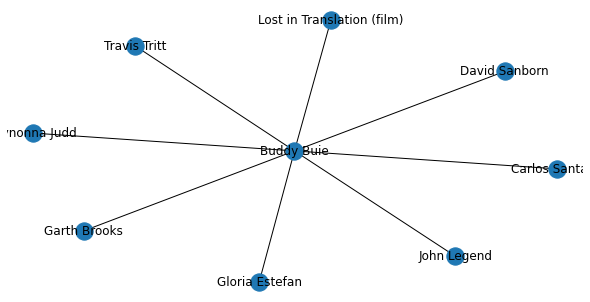

In [58]:
num_in = 195
name_in = getNameByNumber(num_in)
next_nums = getLinksByNumber(num_in)
G1_with_names = nx.Graph()
for num in next_nums:  
    num_name = getNameByNumber(num)
    G1_with_names.add_edge(name_in,num_name)
plt.figure(figsize=(8,4))
nx.draw(G1_with_names, with_labels=True)
plt.show()

#### Without names

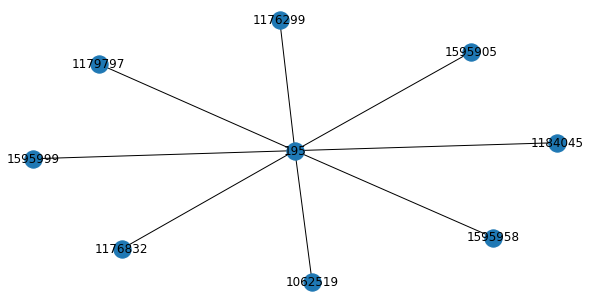

In [60]:
num_in = 195
next_nums = getLinksByNumber(num_in)
G1_no_names = nx.Graph()
for num in next_nums:  
    G1_no_names.add_edge(num_in,num)
plt.figure(figsize=(8,4))
nx.draw(G1_no_names, with_labels=True)
plt.show()

### 2 link deep network

for each of the nodes in the first layer generate the next

- getting the name of each node is inefficient

#### without name

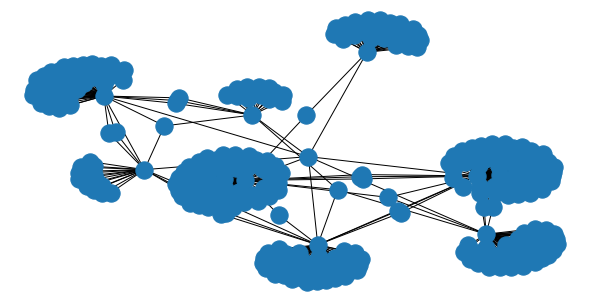

In [62]:
G2_no_names = G1_no_names
for num in next_nums:
    next_nums2 = getLinksByNumber(num)
    for num2 in next_nums2:  
        G2_no_names.add_edge(num,num2)
plt.figure(figsize=(8,4))
nx.draw(G2_no_names, with_labels=False)
plt.show()

#### with name

In [29]:
G2_with_names = G1_with_names
for num in next_nums:
    num_name = getNameByNumber(num)
    next_nums2 = getLinksByNumber(num)
    for num2 in next_nums2:  
        num_name2 = getNameByNumber(num2)
        G2_with_names.add_edge(num_name,num_name2)
plt.figure(figsize=(8,4))
nx.draw(G_no_names, with_labels=True)
plt.show()

# different graph layouts

The standard drawing function in NetworkX becomes very unclear very fast with larger networks.

Here I will compare different graph layouts in the Graphviz package.

In [64]:
G=G2_no_names

## dot

- hierarchical or layered 
- default for directed graph

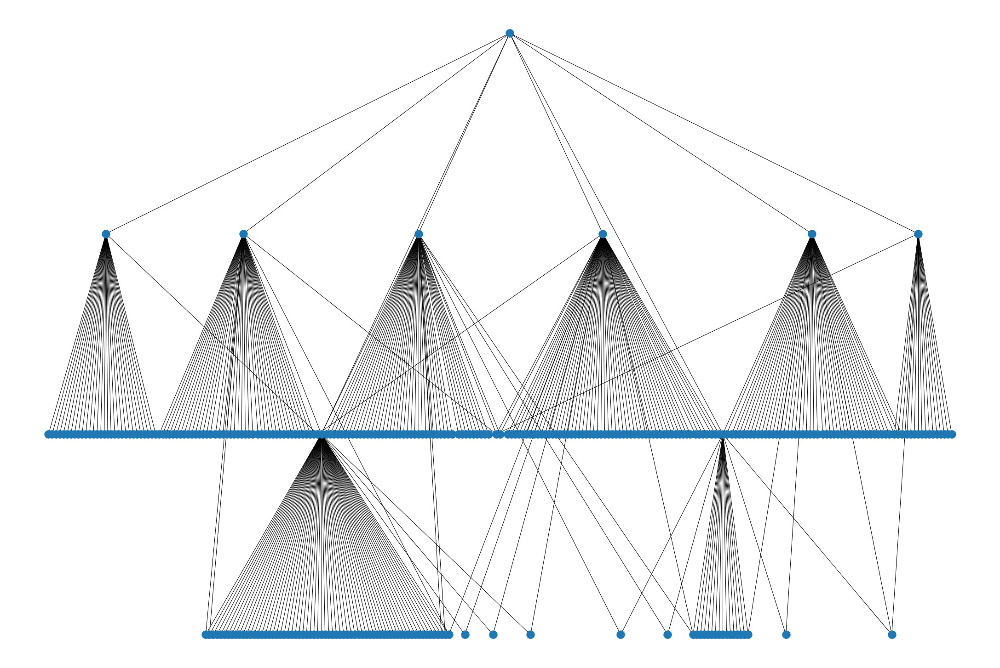

In [65]:
pos = graphviz_layout(G, prog="dot")
plt.figure(figsize=(30,20))
nx.draw(G, pos)
plt.show()

## circo

- circular layout 
- suitable for diagrams with cyclic structures

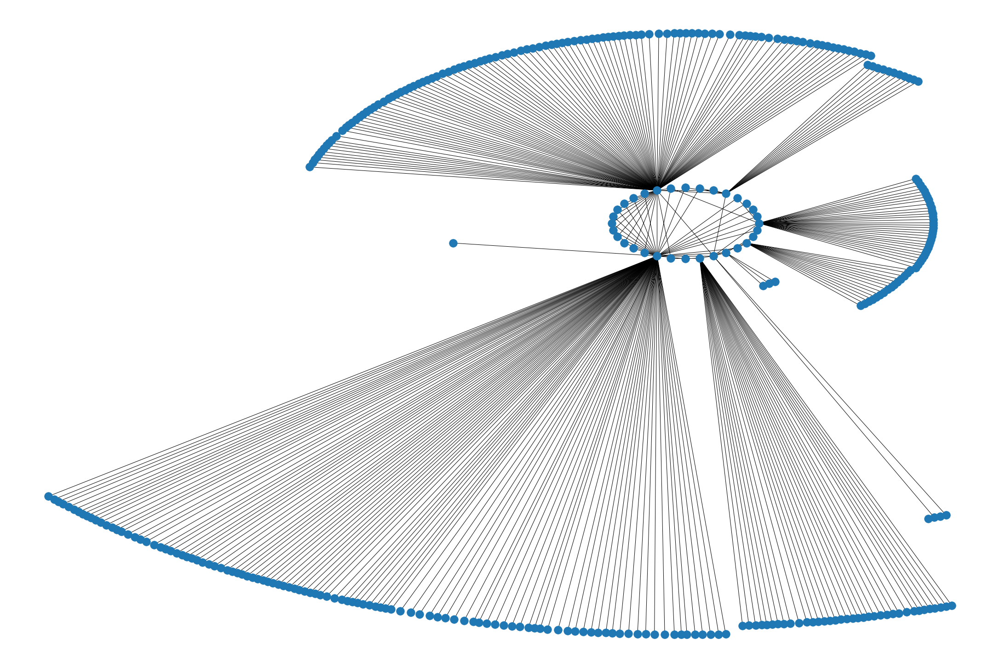

In [37]:
pos = graphviz_layout(G, prog="circo")
plt.figure(figsize=(30,20))
nx.draw(G, pos)
plt.show()


## twopi

- radial layout
- nodes are placed on concentric circles

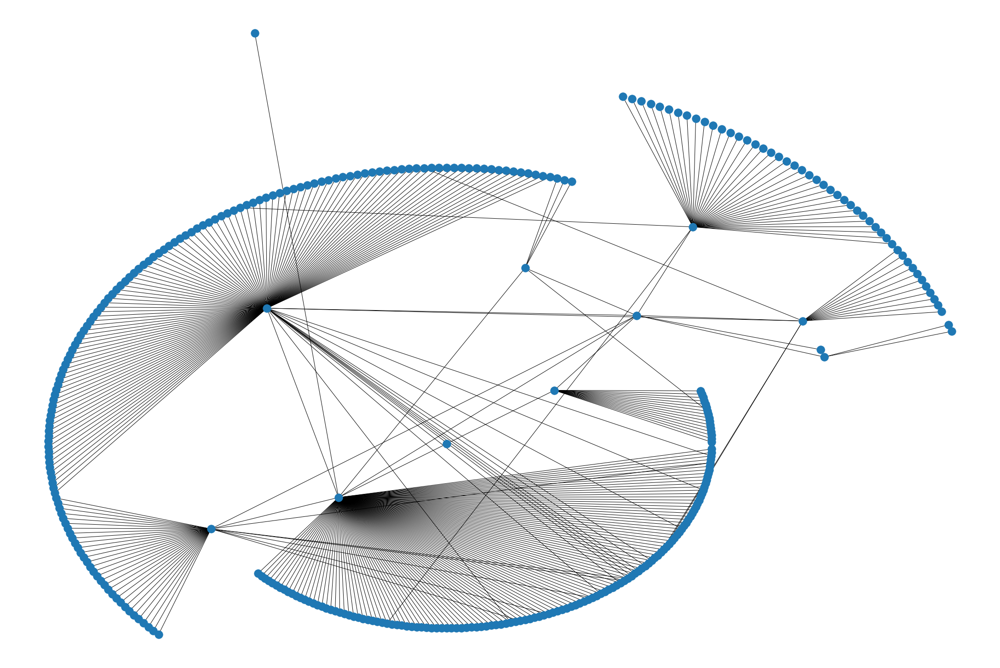

In [40]:
pos = graphviz_layout(G, prog="twopi")
plt.figure(figsize=(30,20))
nx.draw(G, pos)
plt.show()

## neato 

- spring model
- default if graph is not too large (100 nodes) and you don't know much about it 
- attempts to minimize a global energy function (statistical multi-dimensional scaling)


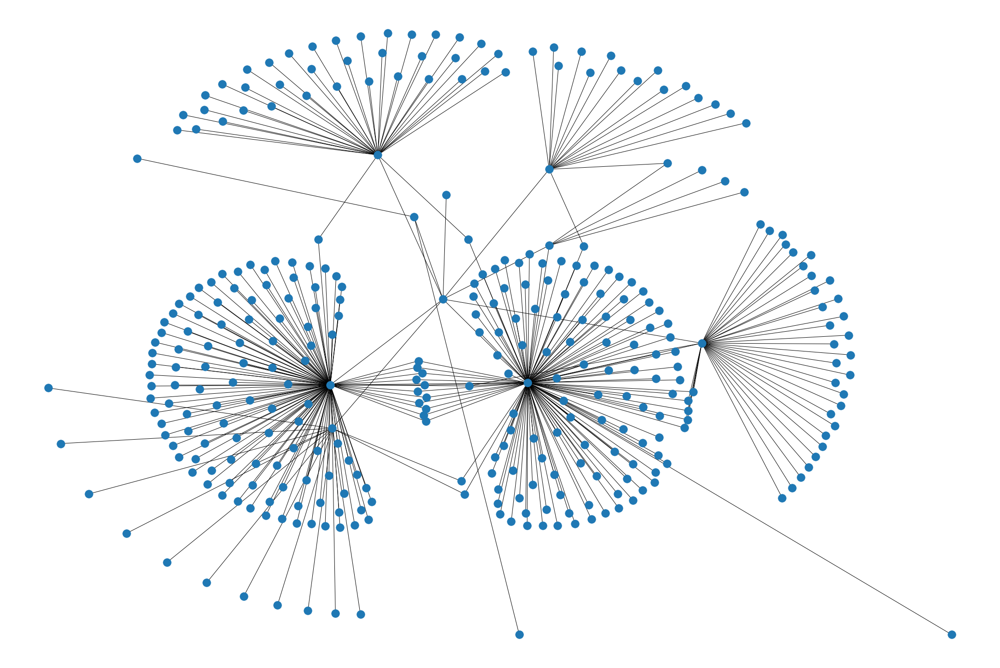

In [39]:
pos = graphviz_layout(G, prog="neato")

plt.figure(figsize=(30,20))
#nx.draw(G, pos,with_labels=True)
nx.draw(G, pos)
plt.show()

## fdp

- spring model like neato
- works with reducing forces rather than energy

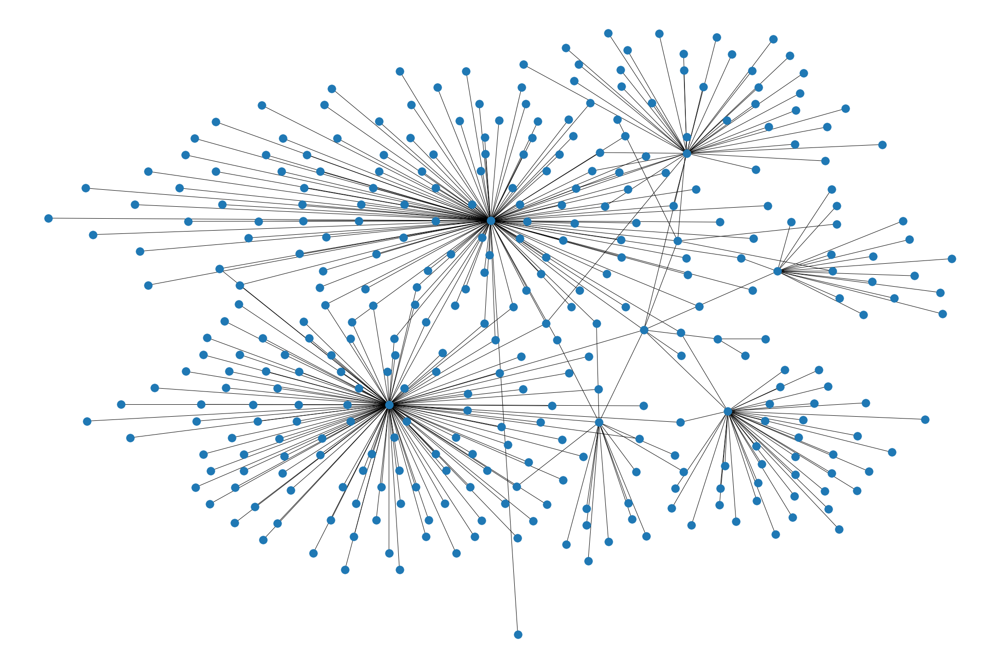

In [38]:
pos = graphviz_layout(G, prog="fdp")
plt.figure(figsize=(30,20))
#nx.draw(G, pos,with_labels=True)
nx.draw(G, pos)
plt.show()

## sfdp

- multiscale version of fdp
- for larger graphs

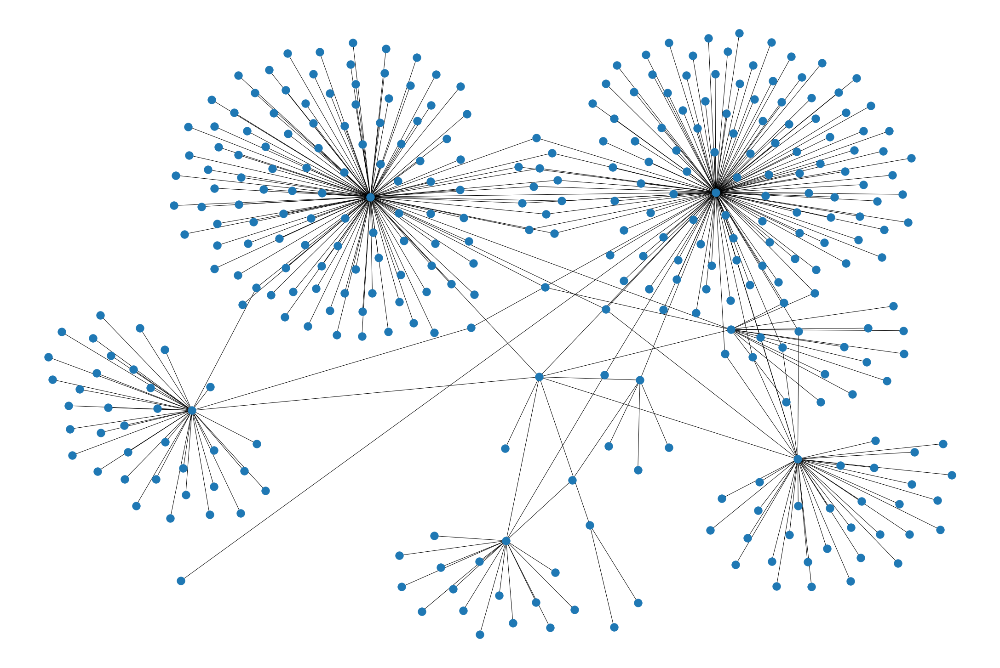

In [42]:
pos = graphviz_layout(G, prog="sfdp")
plt.figure(figsize=(30,20))
#nx.draw(G, pos,with_labels=True)
nx.draw(G, pos)
plt.show()

## network sparse matrix representation

A network can be described as a matrix of dimensions #vertices x #vertices (1791489 x 1791489)

with all values 0 except for edges which get the value of 1 (which makes this a very sparse matrix)

Here I construct and display this matrix because it is a visualization of the network, which is the goal of this project

! plotting the matrix is a large and slow operation because the plotter has to plot 2645247 points
so the code is commented out and there is a picture representation !




In [ ]:
import matplotlib.pylab as plt
import numpy as np
import scipy.sparse as sp

B = sp.lil_matrix((1791489,1791489),dtype=np.int8)

#sample =edges.take(10)
#s_edges= sc.parallelize(sample)

split_edges= edges.map(lambda x: x.split('\t')).collect()

In [ ]:

for id,x in enumerate(split_edges):
    B[int(x[0]),int(x[1])]=1
    if(id%100000==0):
        print(id)
print('matrix loaded')

In [20]:
# plot the matrix
#fig = plt.spy(B,markersize=0.01,marker=".")
#fig.figure.savefig('matrix.png',dpi=500)


<img src="matrix.png" alt="alt text" width="400"/>



## generate arbitrarily deep network

back to the NetworkX visualization



In [17]:
GG = nx.Graph()

### function to recursively generate graph with any dept

In [18]:
def generateGraph(start,depth):
    nexts = getLinksByNumber(start)
    if(depth==1):
        for num in nexts:  
            GG.add_edge(start,num)
    else:
        for num in nexts:
            generateGraph(num,depth-1)

### generate the graph

In [19]:
num_in = 103
depth = 4

print(getNameByNumber(num_in))
generateGraph(num_in,depth)


Steve McDonald (Celtic music)


In [22]:
print(f"the graph has {GG.number_of_nodes()} nodes")
print(f"the graph has {GG.number_of_edges()} edges")

the graph has 4894 nodes
the graph has 6891 edges


### "DOT" representation of 4 level deep graph

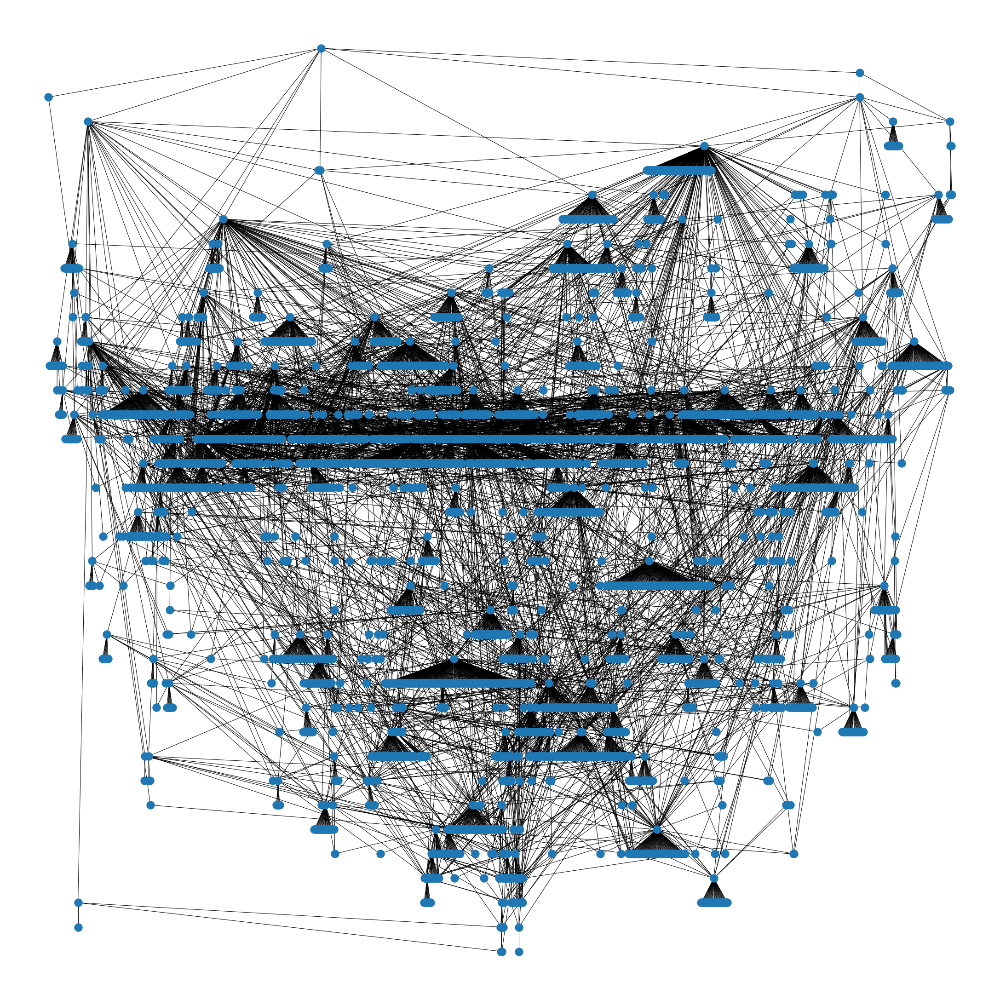

In [21]:
# smoll graphs
pos = graphviz_layout(GG, prog="dot")
plt.figure(figsize=(30,30))

#nx.draw(GG, pos,with_labels=True)
nx.draw(GG, pos)
plt.show()

### "SFDP" representation of 4 level deep graph

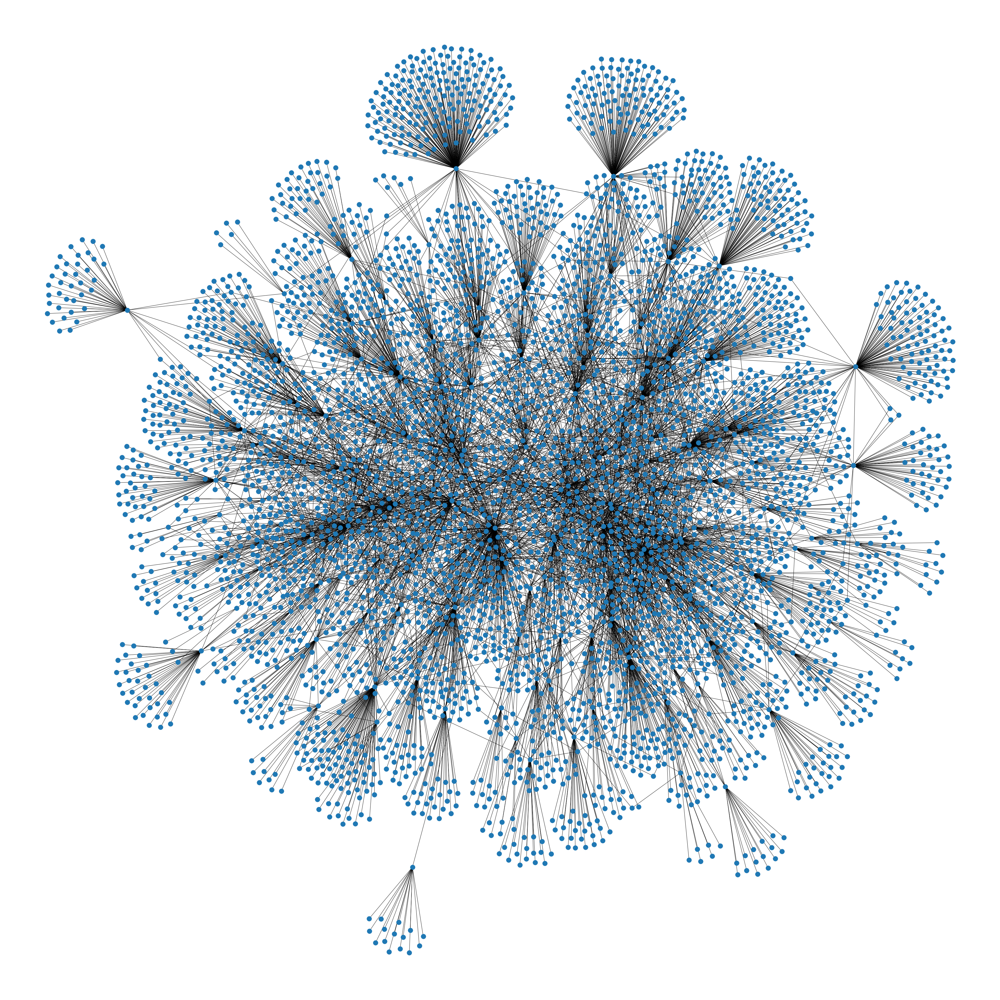

In [55]:
#large graphs
pos = graphviz_layout(GG, prog="sfdp")
plt.figure(figsize=(50,50))
#nx.draw(GG, pos,with_labels=True)
nx.draw(GG, pos)
plt.show()

## GraphFrame

Here I create a GraphFrame object, since Spark Graphx isn't supported in PySpark. It uses a dataframe structure whereas Graphx uses an RDD.

I could have done this sooner but I just recently got it working

In [4]:
edges_split = edges.map(lambda x: x.split('\t'))
vertices_split = names.map(lambda x: x.split(' ')).map(lambda x: (x[0],' '.join(x[1:])))
edges_df = sqlc.createDataFrame(edges_split,["src","dst"])
vertices_df = sqlc.createDataFrame(vertices_split,["id","value"])
gf = GraphFrame(vertices_df,edges_df)

### id's with most outgoing links

In [68]:
gf.outDegrees.orderBy("outDegree",ascending=False).show()

+-------+---------+
|     id|outDegree|
+-------+---------+
|1061816|     1983|
|  82743|     1792|
|1062251|     1782|
|1062319|     1370|
| 946927|     1337|
|1061912|     1328|
|1060883|      932|
|1061304|      907|
| 827296|      906|
|1061262|      891|
| 715041|      879|
|1061636|      769|
|  83510|      757|
| 824169|      691|
|1061640|      685|
|1061314|      650|
| 668316|      627|
|1179434|      565|
|1062028|      540|
| 872898|      494|
+-------+---------+
only showing top 20 rows



In [70]:
gf.vertices.filter("id=1061816").show()

+-------+------------+
|     id|       value|
+-------+------------+
|1061816|2009 in film|
+-------+------------+



### id's with most icoming links

In [71]:
gf.inDegrees.orderBy("inDegree",ascending=False).show()

+-------+--------+
|     id|inDegree|
+-------+--------+
| 279122|   83586|
| 896828|   17056|
| 362517|   14378|
| 785921|   11111|
| 870589|   10834|
|1174967|   10710|
|1457593|   10032|
|1184538|    5918|
| 488567|    5753|
|  81952|    4944|
| 459249|    4575|
| 187620|    4269|
|1061904|    4109|
|1163290|    3760|
|1400548|    3559|
|1394526|    3475|
|1108161|    3372|
|1609252|    3314|
|1400638|    3265|
|1108125|    3216|
+-------+--------+
only showing top 20 rows



In [72]:
gf.vertices.filter("id=279122").show()

+------+-------------+
|    id|        value|
+------+-------------+
|279122|United States|
+------+-------------+



### Search for pairs of vertices with edges in both directions between them.

942,369 * 2 / 2,645,247 = 0.71

71% of links are in both directions, this explains the symmetry in the sparse matrix

In [7]:

motifs =gf.find("(a)-[e]->(b); (b)-[e2]->(a)")
print(f"there are {motifs.count()} double linked vertices")

there are 942369 double linked vertices


### PageRank

Identify important vertices in a graph based on connections.

either
- run until convergence 
- run 10 times


In [13]:
#pageranked = gf.pageRank(resetProbability=0.15, tol=0.01)
pageranked = gf.pageRank(resetProbability=0.15, maxIter=10)

In [18]:
#pageranked.vertices.orderBy("pagerank",ascending=False).show(5)
pageranked.vertices.show(5)

KeyboardInterrupt: 

### wikipedia API

In [19]:
import wikipedia as wk
wk.set_lang("en")


In [ ]:
wk.search("buddy")

page = wk.page("buddy buie")
page.content


In [22]:
page.links

['Abbeville,Alabama',
 'Alabama',
 'Alabama Music Hall of Fame',
 'Allman Brothers Band',
 'Arnie Geller',
 'Atlanta',
 'Atlanta Rhythm Section',
 'B. J. Thomas',
 'BGO Records',
 'Billboard (magazine)',
 'Billy Gilmore',
 'Broadcast Music, Inc.',
 'Classics IV',
 'David Sanborn',
 'Dean Daughtry',
 'Dennis Yost',
 'Doraville',
 'Dothan, Alabama',
 'Dothan Eagle',
 'Eufaula, Alabama',
 'Find a Grave',
 'Garth Brooks',
 'Georgia (U.S. state)',
 'Georgia Music Hall of Fame',
 'Gloria Estefan',
 'Hot 100',
 'IMDb',
 'ISSN (identifier)',
 'I Take It Back',
 'J. R. Cobb',
 'Jimmy Carter',
 'John Legend',
 'Just like Heaven (film)',
 'LCCN (identifier)',
 'Lost in Translation (film)',
 'Mamas and Papas/Soul Train',
 'Marianna, Florida',
 'Michael Huey',
 'Most of All',
 'MusicBrainz',
 'New York City',
 'Record producer',
 'Rock Bottom (Wynonna Judd song)',
 'Roy Orbison',
 'Sandy Posey',
 'Santana (band)',
 'Save Room',
 'So in to You',
 'Southern rock',
 'Spooky (Classics IV song)',
 'Stor

This document became a toolkit for examining a network

An good basis to develop an interactive application

### next steps

- full dataset graph
- 3d representation
- interactable ?
    - click on node to get the name 
- color different layers
- pathfinding ?

- what information can I get from the sparse matrix
- do something with the categories dataset
- page rank